In [2]:
import os

# os.environ["XFORMERS_DISABLED"] = "1"
import sys
from pathlib import Path

SCRIPT_DIR = Path(os.getcwd())  # Sets SCRIPT_DIR to the notebook's directory
print("SCRIPT_DIR:", SCRIPT_DIR)

# Add the neural_networks directory to sys.path for importing modules
sys.path.append(os.path.expanduser('~/projects/astroNNomy/src/astronnomy/training/'))
print("Updated sys.path:", sys.path)
from astronnomy.training.train_nn import *
from torchvision.transforms.functional import hflip
from torchvision.transforms import Resize
torch.set_float32_matmul_precision('high')
import copy
import matplotlib.pyplot as plt
import cv2
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from torch import Tensor
import numpy as np
# os.environ["XFORMERS_DISABLED"] = "1"

SCRIPT_DIR: /gpfs/home2/larsve/projects/astroNNomy/tests
Updated sys.path: ['/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python312.zip', '/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python3.12', '/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python3.12/lib-dynload', '', '/home/larsve/projects/lofar_venv/lib/python3.12/site-packages', '/home/larsve/projects/astroNNomy/src/astronnomy/training/']


In [3]:
sys.path.append(os.path.expanduser('~/.cache/torch/hub/facebookresearch_dnov2_main'))

In [13]:
# Change to get a different number of images in the visualization.
img_per_label = 2
# You can play with this, but I would leave it at 560 to keep it consistent with what we've currently done
img_size = 560
patch_size = 14
w_featmap = img_size // patch_size
h_featmap = img_size // patch_size

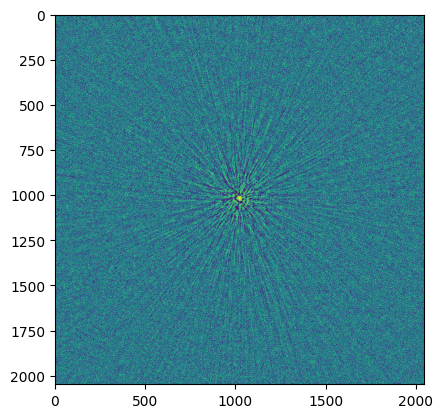

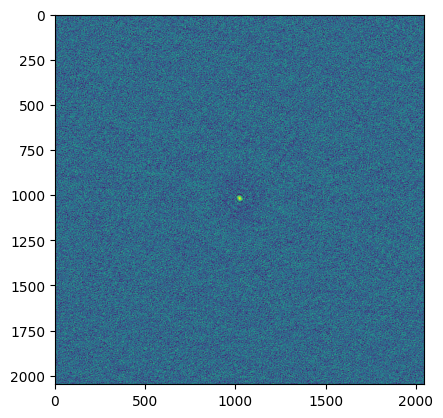

In [5]:
pointsource = {'first_continue': np.load('/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/continue_val/P44832-000.npz')["arr_0"], 
'first_stop': np.load('/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/stop_val/P44832-006.npz')["arr_0"]}
for key, img in pointsource.items():
    plt.imshow(img)
    plt.show()

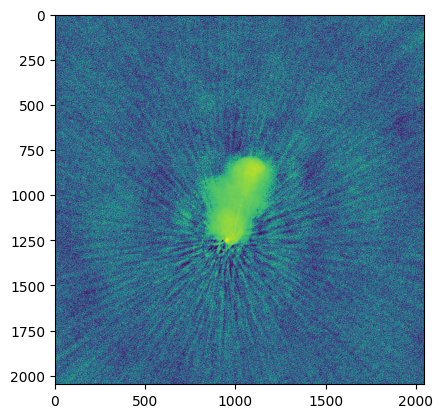

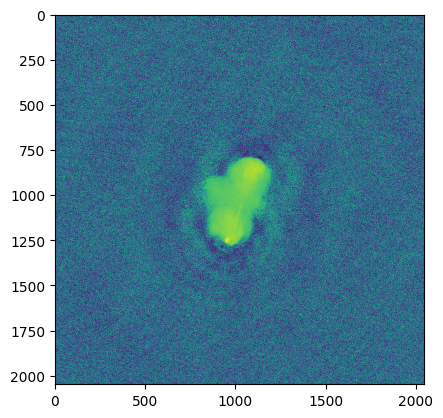

In [6]:
complex_source = {'first_continue': np.load('/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/continue_val/P51372-000.npz')["arr_0"], 
'first_stop': np.load('/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/stop_val/P51372-004.npz')["arr_0"]}
for key, img in complex_source.items():
    plt.imshow(img)
    plt.show()

In [8]:
from cortexchange.wdclient import init_downloader
import os

# Make sure to store these variables.
login = os.getenv("WD_LOGIN")
password = os.getenv("WD_PASSWORD")


init_downloader(
    url="https://researchdrive.surfsara.nl/public.php/webdav/",
    cache=f"{os.path.join(os.path.expanduser('~'), '.cache/cortexchange')}",
    login=login,
    password=password,
)


from cortexchange.architecture import get_architecture, Architecture

Attempting authorization
Attempting authorization


In [60]:
def visualize_attention(attentions, img, labels):
    nh = attentions.shape[1]
    ig, ax = plt.subplots(nh, img_per_label * 4, figsize=(img_per_label * 4 * 4, nh * 4), tight_layout=True, squeeze=True)

    CACHING = True


    for img_id, attention in enumerate(attentions):
        label_name = 'continue' if labels[img_id] else 'stop'
        # attention = attention[:, 0, 5:].reshape(nh, -1)
        attention = attention.reshape(nh, w_featmap, h_featmap)
        attention = nn.functional.interpolate(attention.unsqueeze(0), scale_factor=patch_size, mode="nearest")[0].detach().cpu().to(torch.float32).numpy()
        for n_head, head_attention in enumerate(attention.squeeze()):
            if not n_head:
                ax[n_head, img_id*2].title.set_text(label_name)
            ax[n_head, img_id*2].imshow(img[img_id].cpu().to(torch.float32).numpy().squeeze(), cmap='gray')
            ax[n_head, img_id*2].imshow(head_attention, alpha=1, cmap='magma')
            ax[n_head, img_id*2+1].imshow(img[img_id].cpu().to(torch.float32).numpy().squeeze(), cmap='gray')
            ax[n_head, img_id*2].axis("off")
            ax[n_head, img_id*2+1].axis("off")


            # plt.imshow(head_attention, cmap='gray')
    plt.subplots_adjust(wspace=0, hspace=0)
    # UNCOMMENT TO SAVE FIGURE
    # plt.savefig(f'attention_{model_name}.png')
    plt.show()


In [69]:
USE_CACHED = True
savedir = 'plot_attention'


if USE_CACHED:
    attentions = torch.load(f"{savedir}/attention.pt")
    img = torch.load(f"{savedir}/img.pt")
    labels = torch.load(f"{savedir}/labels.pt")

# This only works with adapted source code.
else:
    with torch.no_grad():
        TransferLearning: type(Architecture) = get_architecture("surf/TransferLearning")
        model = TransferLearning(device="cuda", model_name="surf/dino_big_lora_default_pos_november_09876")
        model.model.eval()
        img = model.prepare_batch(torch.tensor(np.stack(list(pointsource.values()) + list(complex_source.values()))).permute(0, 3, 1,2))
        labels = [1, 0, 1, 0]

        attentions = model.model.dino.encoder.get_last_self_attention(model.model.lift(img)).cpu()
        attentions_slice = attentions[:, :, 0, 5:]

        os.makedirs(savedir, exist_ok=True)
        torch.save(attentions_slice.clone(),f"{savedir}/attention.pt")
        torch.save(img.cpu(),f"{savedir}/img.pt")
        torch.save(labels ,f"{savedir}/labels.pt")


/scratch-local/larsve.9714225/ipykernel_1330/2851606581.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  attentions = torch.load(f"{savedir}/attention.pt")
/scratch-local

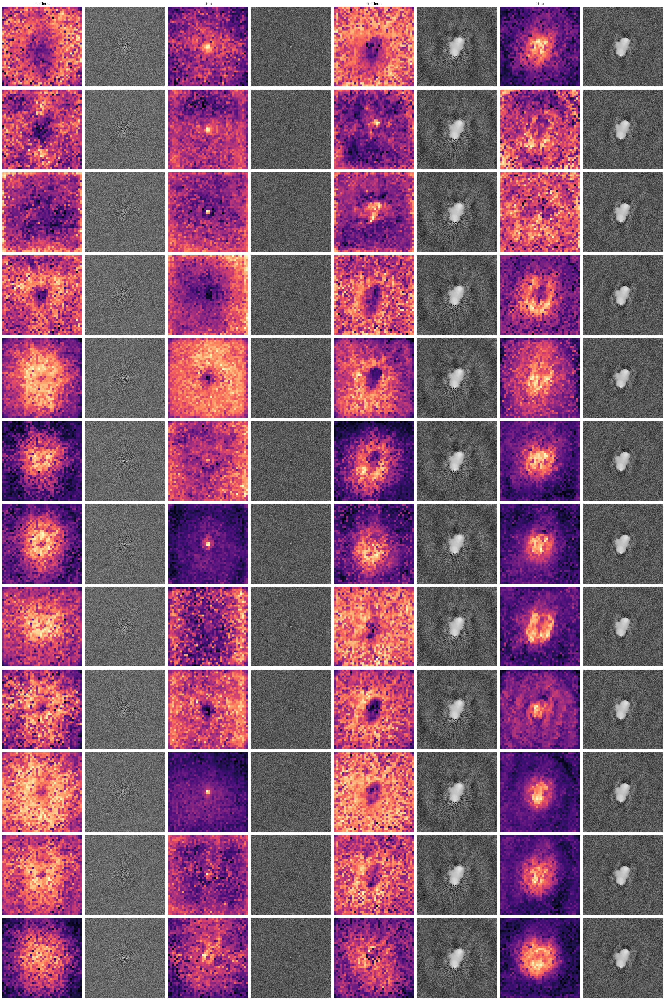

In [70]:
visualize_attention(attentions, img, labels)